In [1]:
# OPTIONAL: Load the "autoreload" extension so that code can change
%load_ext autoreload

# OPTIONAL: always reload modules so that as you change code in src, it gets loaded
%autoreload 2

%matplotlib inline

In [2]:
import os, sys
os.environ["CUDA_VISIBLE_DEVICES"] = "2"
sys.path.append("/home/Developer/NCSN-TF2.0/")

import PIL
import utils, configs
import argparse
import seaborn as sns
import pandas as pd
import numpy as np
import tensorflow as tf
import tensorflow_datasets as tfds
import tensorflow_probability as tfp
import matplotlib.pyplot as plt

from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession
from helper import plot_confusion_matrix, metrics

from datasets.dataset_loader import  *
from tqdm import tqdm
from sklearn.metrics import classification_report, average_precision_score
from sklearn.metrics import roc_auc_score, precision_recall_curve, auc

from sklearn.mixture import GaussianMixture
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

from PIL import Image
from IPython.display import display
from matplotlib.pyplot import imshow
from datetime import datetime

import matplotlib as mpl
import seaborn as sns
import plotly as py
import plotly.graph_objs as go

import umap
from sklearn.preprocessing import MinMaxScaler 

sns.set(style="darkgrid")
mpl.rcParams['figure.dpi'] = 200
plt.rcParams['axes.titlesize'] = 18
plt.rcParams['axes.labelsize'] = 16

seed=42
tf.random.set_seed(seed)
np.random.seed(seed)

tf.__version__

'2.2.0'

In [3]:
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
tf.config.experimental.list_physical_devices('GPU')

Num GPUs Available:  1


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [4]:
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)

In [5]:
LABELS = np.array(["Train", "CIFAR", "CelebA", "SVHN"])
colors = ["red", "blue", "green", "orange"]

## Train Data = L2-norm(Pixel Scores)

In [7]:
from ood_detection_helper import *
import pickle

In [8]:
with open("scores.p", "rb") as f:
    score_dict = pickle.load(f)
score_dict.keys()

dict_keys(['cifar', 'celeba', 'svhn'])

In [9]:
test_data = score_dict["cifar"]
outlier_data_1 = score_dict["celeba"]
outlier_data_2 = score_dict["svhn"]

In [10]:
# Shapes
shapes = [test_data.shape, outlier_data_1.shape, outlier_data_2.shape]

samples = np.concatenate((test_data, outlier_data_1, outlier_data_2))

labels = np.concatenate((np.zeros(test_data.shape[0]),
                         np.ones(outlier_data_1.shape[0]),
                         2*np.ones(outlier_data_2.shape[0])))

captions = np.concatenate([[LABELS[idx]]*shapes[idx-1][0] for idx in range(1,4)])

In [11]:
X_train, X_test =  test_data[:9000], test_data[9000:]
outlier_train = np.concatenate((outlier_data_1[9000:], outlier_data_2[9000:]))

In [12]:
from sklearn.decomposition import PCA, KernelPCA

samples_train = np.concatenate((test_data[:9000], outlier_data_1[:9000], outlier_data_2[:9000]))
samples_test  = np.concatenate((test_data[9000:], outlier_data_1[9000:], outlier_data_2[9000:]))

samples_train.shape

(27000, 10)

In [13]:
def evaluate_model(train_score, test_score, outlier_score, outlier_score_2):
    fig, axs = plt.subplots(2,1, figsize=(16,8))

    sns.distplot(train_score,color=colors[0], label="Training", ax=axs[0])
    sns.distplot(test_score, color=colors[1], label=LABELS[1], ax=axs[0])
    sns.distplot(outlier_score, color=colors[2], label=LABELS[2], ax=axs[0])
    sns.distplot(outlier_score_2, color=colors[3], label=LABELS[3], ax=axs[0])

    sns.distplot(test_score, color=colors[1], label=LABELS[1], ax=axs[1])
    sns.distplot(outlier_score, color=colors[2], label=LABELS[2], ax=axs[1])

    axs[0].legend()
    axs[1].legend()
    plt.show()
    
    ood_metrics(-test_score, -outlier_score_2, names=(LABELS[1], LABELS[3]),
                plot=False, verbose=True)
    print()
    ood_metrics(-test_score, -outlier_score, names=(LABELS[1], LABELS[2]),
                plot=False, verbose=True)
    return

In [15]:
def plot_test_embedding(embedding):
    
    plt.figure(figsize=(20,10))

    captions_test = np.concatenate([[LABELS[idx]]*(shapes[idx-1][0]-9000) for idx in range(1,4)])
    labels_test = np.concatenate([[idx]*(shapes[idx-1][0]-9000) for idx in range(1,4)])
    sns.scatterplot(x=embedding[:, 0],
                    y=embedding[:, 1],
                    hue=captions_test, style=captions_test, s=15, alpha=0.45, palette="muted", edgecolor="none")
    plt.show()
    # plt.close()

    emb3d = go.Scatter3d(
        x=embedding[:,0],
        y=embedding[:,1],
        z=embedding[:,2],
        mode="markers",
        name="Score Norms",
        marker=dict(
            size=2,
            color=labels_test,
            colorscale="Blackbody",
            opacity=0.5,
            showscale=True
        ),
        text=captions_test
    )

    layout = go.Layout(
        title="3D UMAP",
        autosize=False,
        width=1000,
        height=800,
    #     paper_bgcolor='#F5F5F5',
    #     template="plotly"
    )

    data=[emb3d]

    fig = go.Figure(data=data, layout=layout)
    fig.show("notebook")

    return

def plot_train_embedding(embedding):
    
    plt.figure(figsize=(20,10))

    captions_test = np.concatenate([[LABELS[idx]]*(embedding.shape[0]//3) for idx in range(1,4)])
    labels_test = np.concatenate([[idx]*(embedding.shape[0]//3) for idx in range(1,4)])
    sns.scatterplot(x=embedding[:, 0],
                    y=embedding[:, 1],
                    hue=captions_test, style=captions_test, s=15, alpha=0.45, palette="muted", edgecolor="none")
    plt.show()
    # plt.close()

    emb3d = go.Scatter3d(
        x=embedding[:,0],
        y=embedding[:,1],
        z=embedding[:,2],
        mode="markers",
        name="Score Norms",
        marker=dict(
            size=2,
            color=labels_test,
            colorscale="Blackbody",
            opacity=0.5,
            showscale=True
        ),
        text=captions_test
    )

    layout = go.Layout(
        title="3D UMAP",
        autosize=False,
        width=1000,
        height=800,
    #     paper_bgcolor='#F5F5F5',
    #     template="plotly"
    )

    data=[emb3d]

    fig = go.Figure(data=data, layout=layout)
    fig.show("notebook")

    return

In [16]:
def train_gmm(X_train, components_range=range(2,21,2) ,verbose=False):
    
    
    gmm_clf = Pipeline([
        ("scaler", StandardScaler()),
        ("GMM", GaussianMixture())
    ])

    param_grid = dict(GMM__n_components = components_range,
                      GMM__covariance_type = ['full']) # Full always performs best 

    grid = GridSearchCV(estimator=gmm_clf,
                        param_grid=param_grid,
                        cv=10, n_jobs=10,
                        verbose=1)

    grid_result = grid.fit(X_train)
    print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
    if verbose:
        print("-----"*15)
        means = grid_result.cv_results_['mean_test_score']
        stds = grid_result.cv_results_['std_test_score']
        params = grid_result.cv_results_['params']
        for mean, stdev, param in zip(means, stds, params):
            print("%f (%f) with: %r" % (mean, stdev, param))
        plt.plot([p["GMM__n_components"] for p in params], means)

    
    best_gmm_clf = gmm_clf.set_params(**grid.best_params_)
    best_gmm_clf.fit(X_train)
    
    return best_gmm_clf

def train_evaluate_gmm(reducer, verbose=False):
    
    X_train_embedding = reducer.transform(X_train)
    X_test_embedding = reducer.transform(X_test)
    outlier_train_embedding = reducer.transform(outlier_train)

    outlier_1_embedding = reducer.transform(outlier_data_1[9000:]) # Test Samples
    outlier_2_embedding = reducer.transform(outlier_data_2[9000:]) # Test Samples
    
    best_gmm_clf = train_gmm(X_train_embedding, verbose=verbose)
    
    print("Training Likelihood: {:.3f}".format(best_gmm_clf.score(X_train_embedding)))
    print("{} Likelihood: {:.3f}".format(LABELS[1], best_gmm_clf.score(X_test_embedding)))
    print("{} Likelihood: {:.3f}".format(LABELS[2], best_gmm_clf.score(outlier_1_embedding)))
    print("{} Likelihood: {:.3f}".format(LABELS[3], best_gmm_clf.score(outlier_2_embedding)))
    
    train_score = best_gmm_clf.score_samples(X_train_embedding)
    test_score = best_gmm_clf.score_samples(X_test_embedding)
    outlier_score = best_gmm_clf.score_samples(outlier_1_embedding)
    outlier_score_2 = best_gmm_clf.score_samples(outlier_2_embedding)

    evaluate_model(train_score, test_score, outlier_score, outlier_score_2)
    
    return

> # Think about cross validation!

# PCA

In [47]:
%%time

reducer = PCA(n_components=3)
reducer.fit(samples_train[:9000])
print(reducer.explained_variance_ratio_)

[0.52358043 0.35359946 0.09461309]
CPU times: user 545 ms, sys: 995 ms, total: 1.54 s
Wall time: 36.1 ms


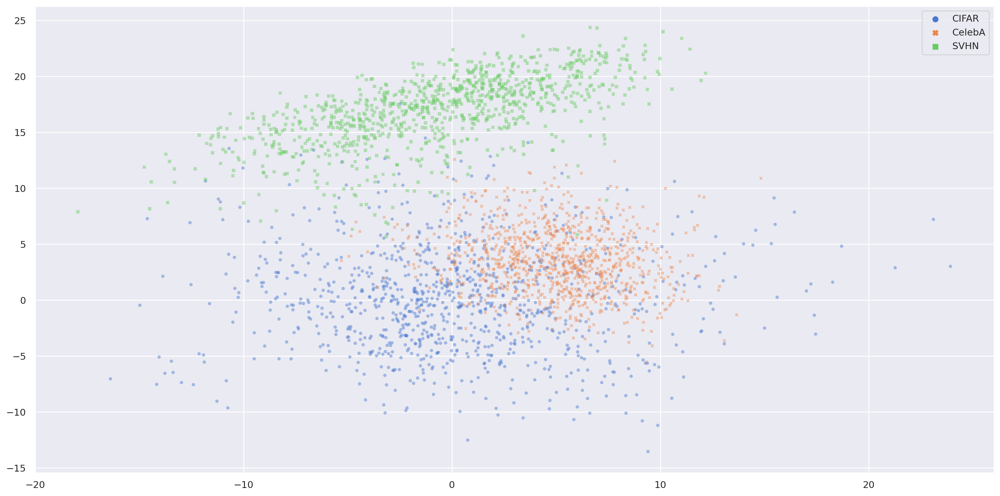

In [48]:
embedding = reducer.transform(samples_test)
plot_test_embedding(embedding)

Fitting 10 folds for each of 10 candidates, totalling 100 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    1.7s
[Parallel(n_jobs=10)]: Done 100 out of 100 | elapsed:    4.2s finished


Best: -4.162041 using {'GMM__covariance_type': 'full', 'GMM__n_components': 16}
Training Likelihood: -4.148
CIFAR Likelihood: -4.162
CelebA Likelihood: -4.426
SVHN Likelihood: -10.977


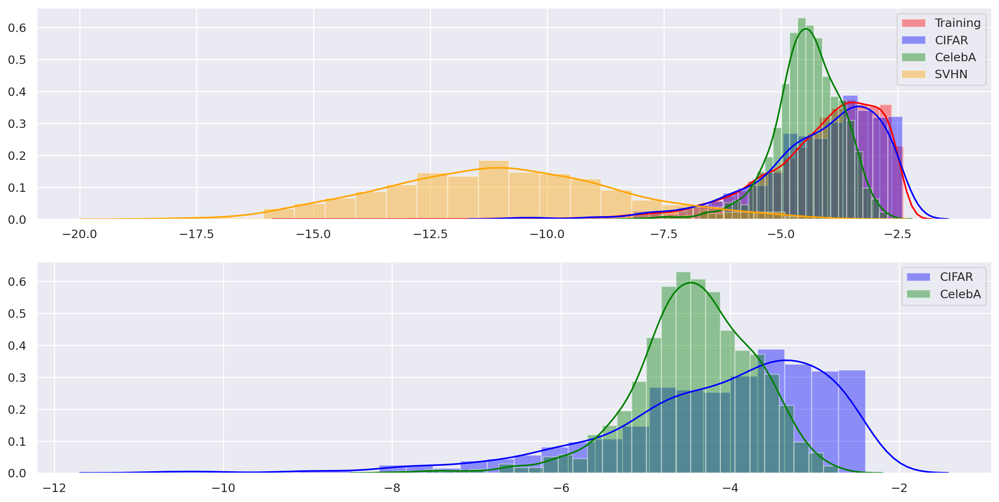

(array([1000, 1001, 1002, 1003]),)
(array([808]),)
CIFAR vs SVHN
----------------
ROC-AUC: 0.9893
PR-AUC (In/Out): 0.9896 / 0.9897
FPR (95% TPR) Prec: 0.0510

(array([1635, 1636, 1637, 1638, 1639, 1640]),)
(array([1320, 1321]),)
CIFAR vs CelebA
----------------
ROC-AUC: 0.6255
PR-AUC (In/Out): 0.5294 / 0.7127
FPR (95% TPR) Prec: 0.6860
CPU times: user 1min 16s, sys: 2.81 s, total: 1min 19s
Wall time: 7.41 s


In [49]:
%time train_evaluate_gmm(reducer)

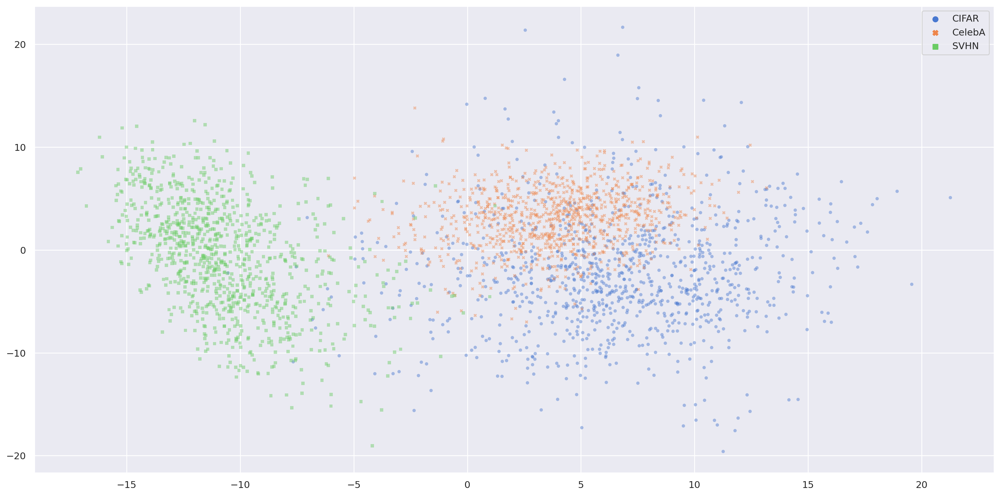

In [18]:
embedding = reducer.transform(samples_test)
plot_test_embedding(embedding)

Fitting 10 folds for each of 10 candidates, totalling 100 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.8s
[Parallel(n_jobs=10)]: Done 100 out of 100 | elapsed:    2.9s finished


Best: -4.126313 using {'GMM__covariance_type': 'full', 'GMM__n_components': 10}
Training Likelihood: -4.118
CIFAR Likelihood: -4.130
CelebA Likelihood: -4.389
SVHN Likelihood: -11.144


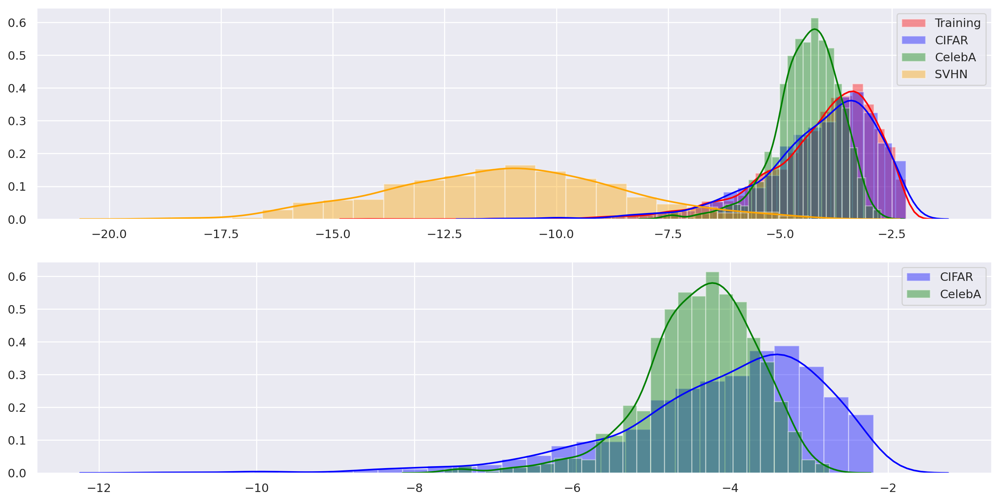

CIFAR vs SVHN
----------------
ROC-AUC: 0.9903
PR-AUC (In/Out): 0.9904 / 0.9908
FPR (95% TPR) Prec: 0.0410

CIFAR vs CelebA
----------------
ROC-AUC: 0.6239
PR-AUC (In/Out): 0.5296 / 0.7120
FPR (95% TPR) Prec: 0.6890
CPU times: user 1min 16s, sys: 3.48 s, total: 1min 20s
Wall time: 5.95 s


In [36]:
%time train_evaluate_gmm(reducer)

# Kernel PCA

In [50]:
%%time

kpca = KernelPCA(n_components=3, kernel="rbf")
kpca.fit(samples_train[:9000])

CPU times: user 30.6 s, sys: 1min 31s, total: 2min 2s
Wall time: 3.9 s


KernelPCA(kernel='rbf', n_components=3)

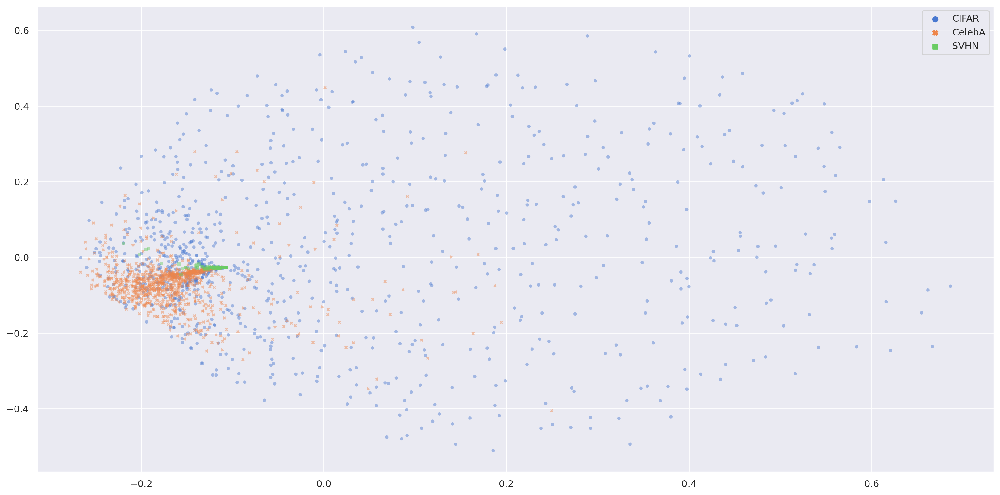

In [51]:
embedding = kpca.transform(samples_test)
plot_test_embedding(embedding)

Fitting 10 folds for each of 10 candidates, totalling 100 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s
[Parallel(n_jobs=10)]: Done 100 out of 100 | elapsed:   16.4s finished


Best: -2.429818 using {'GMM__covariance_type': 'full', 'GMM__n_components': 20}
Training Likelihood: -2.387
CIFAR Likelihood: -2.340
CelebA Likelihood: -0.805
SVHN Likelihood: 8.564


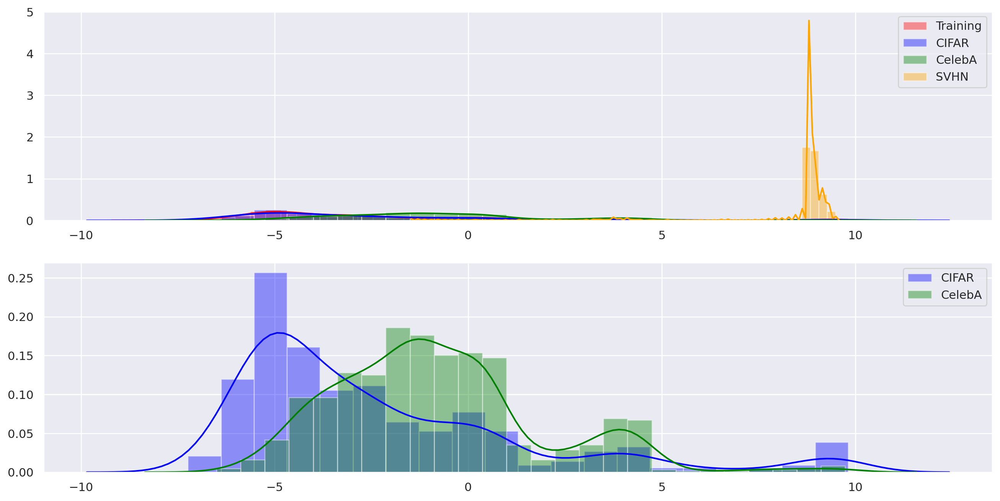

(array([1923, 1924, 1925]),)
(array([1768]),)
CIFAR vs SVHN
----------------
ROC-AUC: 0.0391
PR-AUC (In/Out): 0.3137 / 0.3302
FPR (95% TPR) Prec: 0.9740

(array([1874, 1875, 1876, 1877, 1878]),)
(array([1646]),)
CIFAR vs CelebA
----------------
ROC-AUC: 0.3025
PR-AUC (In/Out): 0.3719 / 0.4395
FPR (95% TPR) Prec: 0.9250
CPU times: user 2min 25s, sys: 2min 32s, total: 4min 57s
Wall time: 28.5 s


In [52]:
%time best_gmm_clf = train_evaluate_gmm(kpca)

# Kernel PCA

In [20]:
%%time

kpca = KernelPCA(n_components=3, kernel="rbf")
kpca.fit(samples_train)

CPU times: user 3min 16s, sys: 3min 4s, total: 6min 21s
Wall time: 28.1 s


KernelPCA(kernel='rbf', n_components=3)

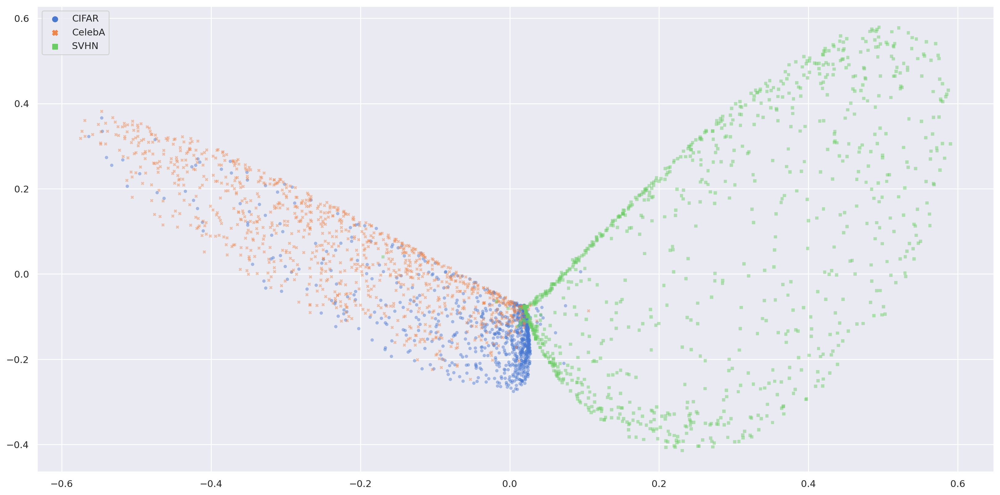

In [21]:
embedding = kpca.transform(samples_test)
plot_test_embedding(embedding)

Fitting 10 folds for each of 10 candidates, totalling 100 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    2.5s
[Parallel(n_jobs=10)]: Done  81 out of 100 | elapsed:    9.7s remaining:    2.3s
[Parallel(n_jobs=10)]: Done 100 out of 100 | elapsed:   13.5s finished


Best: 2.918696 using {'GMM__covariance_type': 'full', 'GMM__n_components': 20}
Training Likelihood: 2.970
CIFAR Likelihood: 2.837
CelebA Likelihood: -1.739
SVHN Likelihood: -50.244


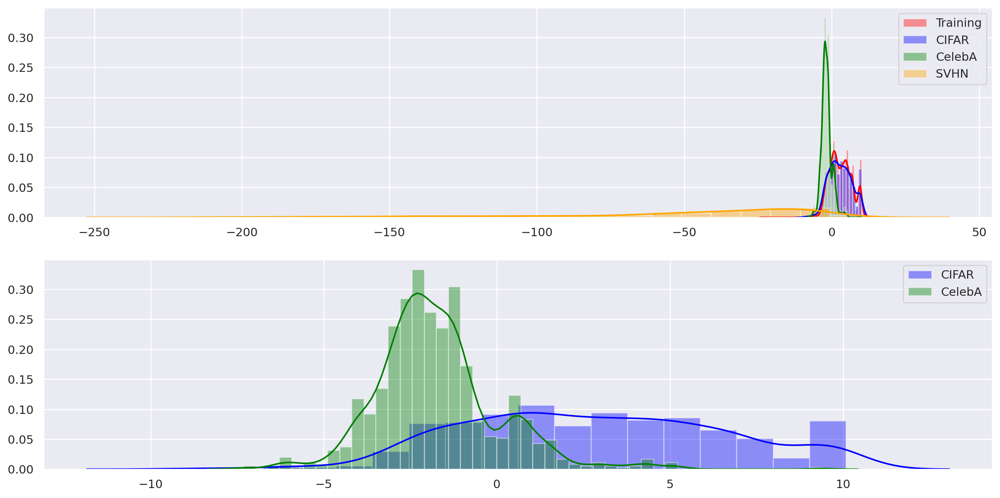

CIFAR vs SVHN
----------------
ROC-AUC: 0.9865
PR-AUC (In/Out): 0.9900 / 0.9816
FPR (95% TPR) Prec: 0.0080

CIFAR vs CelebA
----------------
ROC-AUC: 0.8671
PR-AUC (In/Out): 0.8049 / 0.8918
FPR (95% TPR) Prec: 0.3840
CPU times: user 3min 1s, sys: 5min 17s, total: 8min 19s
Wall time: 35.6 s


In [35]:
%time best_gmm_clf = train_evaluate_gmm(kpca)

# UMAP

In [42]:
%%time
import umap

umapper = umap.UMAP(
                    n_components = 3,
                    n_neighbors=50,
                    min_dist=0.1)

umapper.fit(samples_train)

CPU times: user 12min 38s, sys: 1min 30s, total: 14min 8s
Wall time: 33.5 s


UMAP(n_components=3, n_neighbors=50)

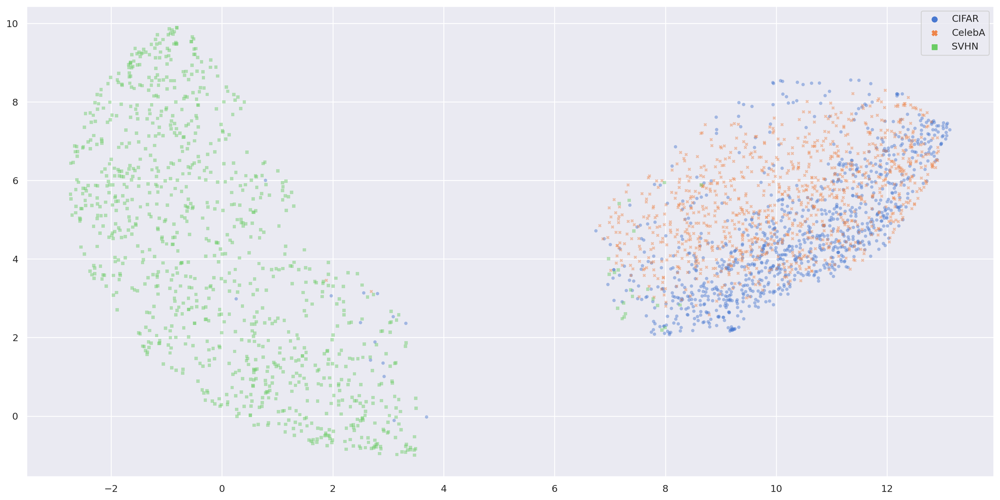

In [43]:
embedding = umapper.transform(samples_test)
plot_test_embedding(embedding)

Fitting 10 folds for each of 10 candidates, totalling 100 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    1.5s
[Parallel(n_jobs=10)]: Done 100 out of 100 | elapsed:    7.9s finished


Best: -2.592705 using {'GMM__covariance_type': 'full', 'GMM__n_components': 20}
Training Likelihood: -2.580
CIFAR Likelihood: -2.637
CelebA Likelihood: -4.098
SVHN Likelihood: -23.252


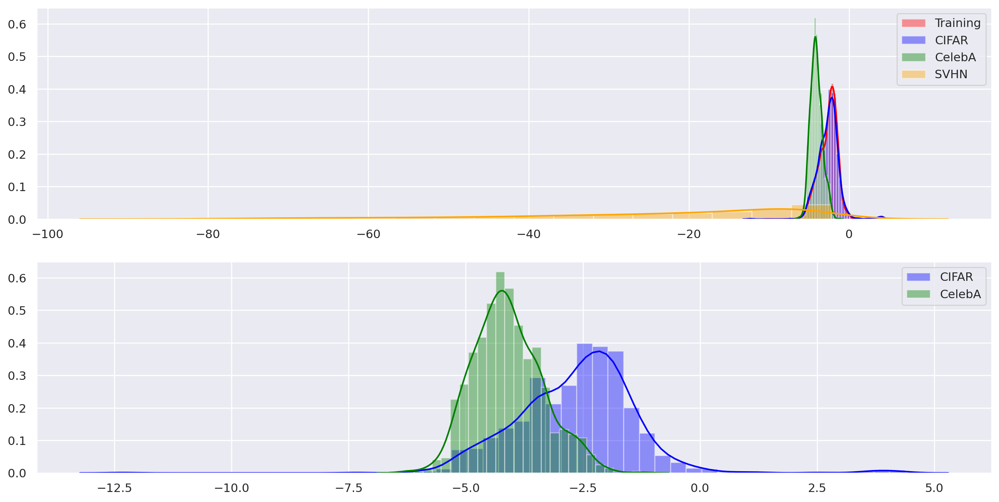

CIFAR vs SVHN
----------------
ROC-AUC: 0.9866
PR-AUC (In/Out): 0.9884 / 0.9856
FPR (95% TPR) Prec: 0.1040

CIFAR vs CelebA
----------------
ROC-AUC: 0.8463
PR-AUC (In/Out): 0.7737 / 0.8780
FPR (95% TPR) Prec: 0.4220
CPU times: user 4min 39s, sys: 2.73 s, total: 4min 42s
Wall time: 29.5 s


In [44]:
%time train_evaluate_gmm(umapper)

## t-SNE

In [23]:
%%time

from MulticoreTSNE import MulticoreTSNE as TSNE

tsne = TSNE(n_components=3, perplexity=50, n_jobs=24)

embeddings = tsne.fit_transform(samples)

CPU times: user 36min 21s, sys: 4.56 s, total: 36min 25s
Wall time: 3min 6s


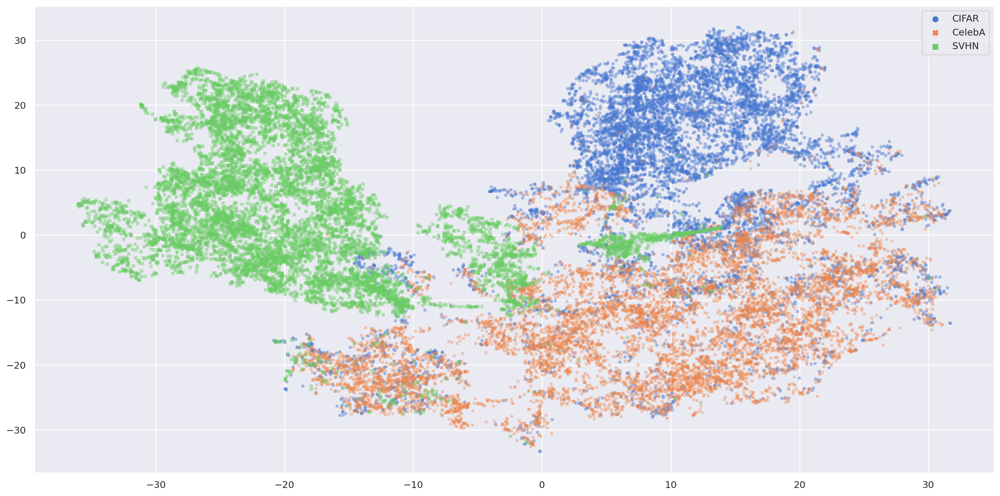

In [24]:
plot_train_embedding(embeddings)

In [29]:
X_train_embedding =  embeddings[:9000]
X_test_embedding = embeddings[9000:10000]

outliers_train = np.concatenate((embeddings[10000:19000], embeddings[20000:29000]))
outlier_1_embedding, outlier_2_embedding = embeddings[19000:20000], embeddings[29000:]

test_embeddings = np.concatenate(
    (X_test_embedding, outlier_1_embedding, outlier_2_embedding))
test_embeddings.shape

(3000, 3)

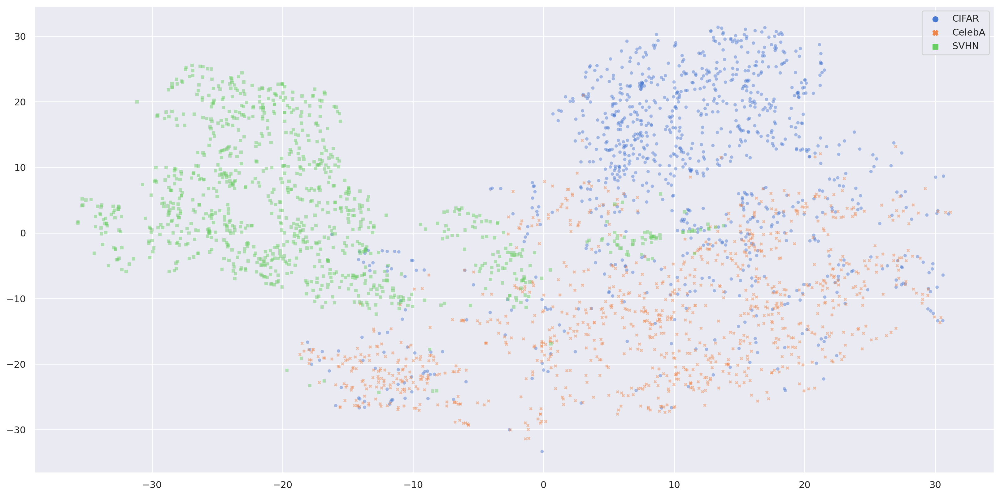

In [30]:
plot_test_embedding(test_embeddings)

## GMM - Likelihood Based

In [37]:
%time best_gmm_clf = train_gmm(X_train_embedding, components_range=range(2,21,2))

Fitting 10 folds for each of 10 candidates, totalling 100 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    1.3s
[Parallel(n_jobs=10)]: Done 100 out of 100 | elapsed:    4.6s finished


Best: -2.928444 using {'GMM__covariance_type': 'full', 'GMM__n_components': 20}
CPU times: user 1min 6s, sys: 5.22 s, total: 1min 12s
Wall time: 6.68 s


Training Likelihood: -2.894
CIFAR Likelihood: -2.980
CelebA Likelihood: -4.748
SVHN Likelihood: -23.769


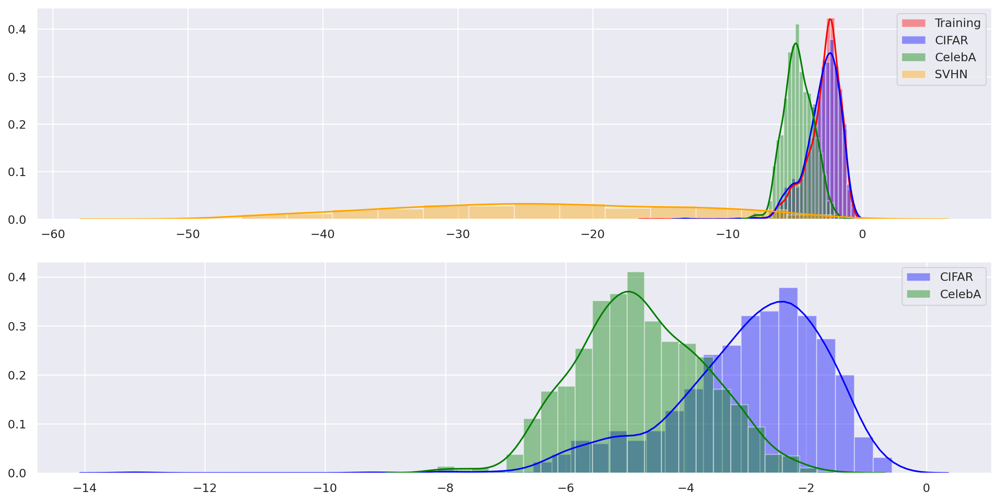

CIFAR vs SVHN
----------------
ROC-AUC: 0.9908
PR-AUC (In/Out): 0.9931 / 0.9881
FPR (95% TPR) Prec: 0.0060

CIFAR vs CelebA
----------------
ROC-AUC: 0.8559
PR-AUC (In/Out): 0.7983 / 0.8803
FPR (95% TPR) Prec: 0.4280


In [38]:
print("Training Likelihood: {:.3f}".format(best_gmm_clf.score(X_train_embedding)))
print("{} Likelihood: {:.3f}".format(LABELS[1], best_gmm_clf.score(X_test_embedding)))
print("{} Likelihood: {:.3f}".format(LABELS[2], best_gmm_clf.score(outlier_1_embedding)))
print("{} Likelihood: {:.3f}".format(LABELS[3], best_gmm_clf.score(outlier_2_embedding)))

train_score = best_gmm_clf.score_samples(X_train_embedding)
test_score = best_gmm_clf.score_samples(X_test_embedding)
outlier_score = best_gmm_clf.score_samples(outlier_1_embedding)
outlier_score_2 = best_gmm_clf.score_samples(outlier_2_embedding)

evaluate_model(train_score, test_score, outlier_score, outlier_score_2)